<a href="https://colab.research.google.com/github/aeshmawy/DataAnalysis/blob/main/CS_210_Final_Report.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Exploring the given AirBNB Dataset

Ahmed Eshmawy 26294

Muhammad Haider Khan Jadoon 26267

Group ID: 34

##Introduction
Our interest for this project is to see whether crime in certain neighbourhood has an effect on the pricing of AirBnB listing. It is a logical assumption that higher crime rates has an inverse effect on pricing i.e higher the crime rate, lower the prices of the AirBnBs. Through our supplementary NYC-Arrests datasets we tried to explore whether this is a viable assumption.

##Problem Definition
The problem we are trying to solve is if price and crime are correlated and whether we can accurately predict the price range of an AirBnB based on the number of crime around that AirBnB. We will achieve that by comparing the locations of each AirBnB with the a secondary dataset of arrests. In order to achieve our goal, we tried to find out if they are correlated through hypothesis testing and used Machine learning for the last step.

In [ ]:
from google.colab import drive
drive.mount("/content/gdrive", force_remount=True)

Mounted at /content/gdrive


In [ ]:
import pandas as pd  # an alias for pandas
import numpy as np
import matplotlib.pyplot as plt
from os.path import join

%matplotlib inline

In [ ]:


data_path = "/content/gdrive/My Drive"
filename = "NYCAirBNB.csv"

df = pd.read_csv(join(data_path, filename), delimiter = ",")

##Taking a look at the dataset
We used the .head() and .tail() functions to look at the airbnb dataset. As price is of interest to us, our analysis looks further into it and the factors effecting the pricings of Air BnBs along with supplementary datasets.

In [ ]:
df.head(5)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,10/19/2018,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,5/21/2019,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,7/5/2019,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,11/19/2018,0.10,1,0


In [ ]:
df.tail(5)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
48890,36484665,Charming one bedroom - newly renovated rowhouse,8232441,Sabrina,Brooklyn,Bedford-Stuyvesant,40.67853,-73.94995,Private room,70,2,0,NaN,NaN,2,9
48891,36485057,Affordable room in Bushwick/East Williamsburg,6570630,Marisol,Brooklyn,Bushwick,40.70184,-73.93317,Private room,40,4,0,NaN,NaN,2,36
48892,36485431,Sunny Studio at Historical Neighborhood,23492952,Ilgar & Aysel,Manhattan,Harlem,40.81475,-73.94867,Entire home/apt,115,10,0,NaN,NaN,1,27
48893,36485609,43rd St. Time Square-cozy single bed,30985759,Taz,Manhattan,Hell's Kitchen,40.75751,-73.99112,Shared room,55,1,0,NaN,NaN,6,2
48894,36487245,Trendy duplex in the very heart of Hell's Kitchen,68119814,Christophe,Manhattan,Hell's Kitchen,40.76404,-73.98933,Private room,90,7,0,NaN,NaN,1,23


###Categorizing Price
We split price into 5 different categories depending on how much it costs per night.
The categories are <font color='red'>Cheap</font>, <font color='red'>Okay</font>, <font color='red'>Moderate</font> , <font color='red'>Expensive</font> and <font color='red'>Really Expensive</font>. Respectively they are less than 50 , less than 100 , less than 150, less than 200 , and the last one is anything greater than 200. This categorization will help us in later analysis.

In [ ]:
def categorizeprice(info):
  if(info <= 50):
    return "Cheap"
  elif(info <= 100):
    return "Ok"
  elif(info <= 150):
    return "Moderate"
  elif(info <= 200):
    return "Expensive"
  elif(info > 200):
    return "Really Expensive"
df['price_category'] = df['price'].apply(categorizeprice)
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_category
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,10/19/2018,0.21,6,365,Moderate
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,5/21/2019,0.38,2,355,Really Expensive
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365,Moderate
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,7/5/2019,4.64,1,194,Ok
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,11/19/2018,0.10,1,0,Ok


###Roomtypes according to price category
We investigate the distribution of roomtypes according to the price catogeries we defined beforehand.

In [ ]:
roomtypes=[]
for x in df["room_type"]:
  if x not in roomtypes:
    roomtypes.append(x)
print(roomtypes)

nbh=[]
for y in df["neighbourhood_group"]:
  if y not in nbh:
    nbh.append(y)
print(nbh)
roomdict={"Private room":0,"Entire home/apt":0,"Shared room":0}
roomdict1={"Private room":0,"Entire home/apt":0,"Shared room":0}
roomdict2={"Private room":0,"Entire home/apt":0,"Shared room":0}
roomdict3={"Private room":0,"Entire home/apt":0,"Shared room":0}
roomdict4={"Private room":0,"Entire home/apt":0,"Shared room":0}
countc=0
counto=0
countm=0
counte=0
countre=0

for j in df[["price" ,"room_type"]].values:
  if j[0]<=50:
    countc+=1
    if j[1] == "Private room":
      roomdict["Private room"]+=1
    if j[1] == "Entire home/apt":
      roomdict["Entire home/apt"]+=1
    if j[1] == "Shared room":
      roomdict["Shared room"]+=1
  if j[0]>50 and j[0]<=100:
    counto+=1
    if j[1] == "Private room":
      roomdict1["Private room"]+=1
    if j[1] == "Entire home/apt":
      roomdict1["Entire home/apt"]+=1
    if j[1] == "Shared room":
      roomdict1["Shared room"]+=1
  if j[0]>100 and j[0]<=150:
    countm+=1
    if j[1] == "Private room":
      roomdict2["Private room"]+=1
    if j[1] == "Entire home/apt":
      roomdict2["Entire home/apt"]+=1
    if j[1] == "Shared room":
      roomdict2["Shared room"]+=1
  if j[0]>150 and j[0]<=200:
    counte+=1
    if j[1] == "Private room":
      roomdict3["Private room"]+=1
    if j[1] == "Entire home/apt":
      roomdict3["Entire home/apt"]+=1
    if j[1] == "Shared room":
      roomdict3["Shared room"]+=1
  if j[0]>200:
    countre+=1
    if j[1] == "Private room":
      roomdict4["Private room"]+=1
    if j[1] == "Entire home/apt":
      roomdict4["Entire home/apt"]+=1
    if j[1] == "Shared room":
      roomdict4["Shared room"]+=1

print("Count for cheap prices:",countc)
print("Count for okay prices:",counto)
print("Count for moderate prices:",countm)
print("Count for expensive prices:",counte)
print("Count for really expensive prices:",countre)
print("******************************************************************************************************")
print ("Room dictionary for cheap:")
for x, y in roomdict.items():
  print(x, y)
print("******************************************************************************************************")
print ("Room dictionary for okay:")
for x, y in roomdict1.items():
  print(x, y)
print("******************************************************************************************************")
print ("Room dictionary for moderate:")
for x, y in roomdict2.items():
  print(x, y)
print("******************************************************************************************************")
print ("Room dictionary for expensive:")
for x, y in roomdict3.items():
  print(x, y)
print("******************************************************************************************************")
print ("Room dictionary for really expensive:")
for x, y in roomdict4.items():
  print(x, y)

['Private room', 'Entire home/apt', 'Shared room']
['Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Bronx']
Count for cheap prices: 6561
Count for okay prices: 17367
Count for moderate prices: 10029
Count for expensive prices: 6554
Count for really expensive prices: 8384
******************************************************************************************************
Room dictionary for cheap:
Private room 5708
Entire home/apt 190
Shared room 663
******************************************************************************************************
Room dictionary for okay:
Private room 12614
Entire home/apt 4384
Shared room 369
******************************************************************************************************
Room dictionary for moderate:
Private room 2586
Entire home/apt 7383
Shared room 60
******************************************************************************************************
Room dictionary for expensive:
Private room 711
Entire home/apt 

####Observation regarding roomtypes
We graphed the distribution of each graph according to its price catergory which shows that Entire homes and apartments get more dominant as it gets more expensive while Private and shared rooms are more common for a cheaper price.

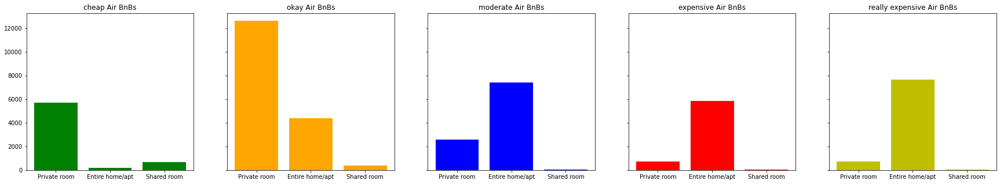

In [ ]:
fig, axs = plt.subplots(1, 5, figsize=(30, 5), sharey=True)

axs[0].bar(list(roomdict.keys()), roomdict.values(), color='g')
axs[0].title.set_text('cheap Air BnBs')

axs[1].bar(list(roomdict1.keys()), roomdict1.values(), color='orange')
axs[1].title.set_text('okay Air BnBs')

axs[2].bar(list(roomdict2.keys()), roomdict2.values(), color='b')
axs[2].title.set_text('moderate Air BnBs')

axs[3].bar(list(roomdict3.keys()), roomdict3.values(), color='r')
axs[3].title.set_text('expensive Air BnBs')

axs[4].bar(list(roomdict4.keys()), roomdict4.values(), color='y')
axs[4].title.set_text('really expensive Air BnBs')


plt.show()

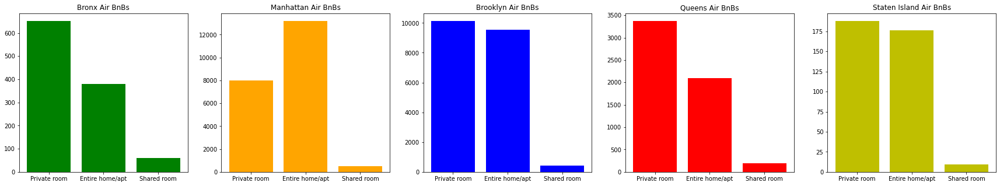

In [ ]:
fig, axs = plt.subplots(1, 5, figsize=(30, 5), sharey=False)

axs[0].bar(dfBronx.room_type.unique(), [(dfBronx.room_type == 'Private room').sum(),(dfBronx.room_type == 'Entire home/apt').sum(),(dfBronx.room_type == 'Shared room').sum()], color='g')
axs[0].title.set_text('Bronx Air BnBs')

axs[1].bar(dfBronx.room_type.unique(), [(dfManhattan.room_type == 'Private room').sum(),(dfManhattan.room_type == 'Entire home/apt').sum(),(dfManhattan.room_type == 'Shared room').sum()], color='orange')
axs[1].title.set_text('Manhattan Air BnBs')

axs[2].bar(dfBrooklyn.room_type.unique(), [(dfBrooklyn.room_type == 'Private room').sum(),(dfBrooklyn.room_type == 'Entire home/apt').sum(),(dfBrooklyn.room_type == 'Shared room').sum()], color='b')
axs[2].title.set_text('Brooklyn Air BnBs')

axs[3].bar(dfQueens.room_type.unique(), [(dfQueens.room_type == 'Private room').sum(),(dfQueens.room_type == 'Entire home/apt').sum(),(dfQueens.room_type == 'Shared room').sum()], color='r')
axs[3].title.set_text('Queens Air BnBs')

axs[4].bar(dfStaten.room_type.unique(), [(dfStaten.room_type == 'Private room').sum(),(dfStaten.room_type == 'Entire home/apt').sum(),(dfStaten.room_type == 'Shared room').sum()], color='y')
axs[4].title.set_text('Staten Island Air BnBs')


plt.show()


In the above graphs we can observe that Manhattan is one of the more expensive neighbourhood groups due to its large <font color='red'>Entire home/apt</font> percentage.

All the other neighbour hood groups follow a similar distribution.

###Seperating by Neighbourhood Groups
Due to the nature of our question, it is in our intereset to seperate the data set into 5 smaller dataset depending on the neighbourhood group.

We sorted them depending on neighbourhood groups and remove AirBnBs that are no longer available.

We check their counts to know what the more populous ones are and to be informed of the missing values.


In [ ]:
df.neighbourhood_group.unique()

dfAvail = df[df["availability_365"] != 0]

dfBrooklyn = df[df["neighbourhood_group"] == "Brooklyn"]
dfBrooklyn.mean()

dfBrooklynCheap = dfBrooklyn[dfBrooklyn["price"] < 50]
dfBrooklynAvail = dfBrooklyn[dfBrooklyn["availability_365"] != 0]
dfBrooklynSample = dfBrooklynAvail[:1000]
dfBrooklynAvail.count()

id                                12260
name                              12259
host_id                           12260
host_name                         12256
neighbourhood_group               12260
neighbourhood                     12260
latitude                          12260
longitude                         12260
room_type                         12260
price                             12260
minimum_nights                    12260
number_of_reviews                 12260
last_review                       10664
reviews_per_month                 10664
calculated_host_listings_count    12260
availability_365                  12260
price_category                    12260
dtype: int64

In [ ]:
dfManhattan = df[df["neighbourhood_group"] == "Manhattan"]
dfManhattanCheap = dfManhattan[dfManhattan["price"] < 50]
dfManhattanAvail = dfManhattan[dfManhattan["availability_365"] != 0]
dfManhattanSample = dfManhattanAvail[:1000]
dfManhattanAvail.count()

id                                13559
name                              13557
host_id                           13559
host_name                         13557
neighbourhood_group               13559
neighbourhood                     13559
latitude                          13559
longitude                         13559
room_type                         13559
price                             13559
minimum_nights                    13559
number_of_reviews                 13559
last_review                       10813
reviews_per_month                 10813
calculated_host_listings_count    13559
availability_365                  13559
price_category                    13559
dtype: int64

In [ ]:
dfQueens = df[df["neighbourhood_group"] == "Queens"]
dfQueensCheap = dfQueens[dfQueens["price"] < 50]
dfQueensAvail = dfQueens[dfQueens["availability_365"] != 0]
dfQueensSample = dfQueensAvail[:1000]
dfQueensAvail.count()


id                                4298
name                              4298
host_id                           4298
host_name                         4297
neighbourhood_group               4298
neighbourhood                     4298
latitude                          4298
longitude                         4298
room_type                         4298
price                             4298
minimum_nights                    4298
number_of_reviews                 4298
last_review                       3635
reviews_per_month                 3635
calculated_host_listings_count    4298
availability_365                  4298
price_category                    4298
dtype: int64

In [ ]:
dfStaten = df[df["neighbourhood_group"] == "Staten Island"]
dfStatenCheap = dfStaten[dfStaten["price"] < 50]
dfStatenAvail = dfStaten[dfStaten["availability_365"] != 0]
dfStatenAvail.count()

id                                331
name                              331
host_id                           331
host_name                         331
neighbourhood_group               331
neighbourhood                     331
latitude                          331
longitude                         331
room_type                         331
price                             331
minimum_nights                    331
number_of_reviews                 331
last_review                       287
reviews_per_month                 287
calculated_host_listings_count    331
availability_365                  331
price_category                    331
dtype: int64

In [ ]:
dfBronx = df[df["neighbourhood_group"] == "Bronx"]
dfBronxCheap = dfBronx[dfBronx["price"] < 50]
dfBronxAvail = dfBronx[dfBronx["availability_365"] != 0]
dfBronxAvail.count()

id                                914
name                              913
host_id                           914
host_name                         913
neighbourhood_group               914
neighbourhood                     914
latitude                          914
longitude                         914
room_type                         914
price                             914
minimum_nights                    914
number_of_reviews                 914
last_review                       756
reviews_per_month                 756
calculated_host_listings_count    914
availability_365                  914
price_category                    914
dtype: int64

In [ ]:
df.fillna({'reviews_per_month':0}, inplace=True)

####Which Neighbourhood group is the cheapest?
We made a piechart to investigate which neighbourhood is the cheapest but this might be skewed due to how much more populous certain districts are compared to others.

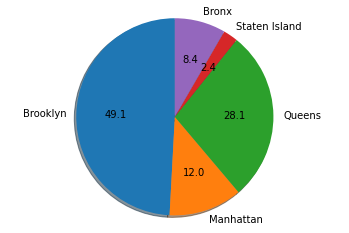

In [ ]:
dfCheap = df[df["price"] < 50]
dfCheapandAvail = dfCheap[dfCheap["availability_365"] != 0]
  
labels = 'Brooklyn' , 'Manhattan' , 'Queens', 'Staten Island', 'Bronx'
count= [0 ,0 ,0 ,0 , 0]

for i in dfCheapandAvail[["neighbourhood_group"]].values:
    if(i[0] == "Brooklyn"):
      count[0] += 1
    elif(i[0] == "Manhattan"):
      count[1] += 1
    elif(i[0] == "Queens"):
      count[2] += 1
    elif(i[0] == "Staten Island"):
      count[3] += 1
    elif(i[0] == "Bronx"):
      count[4] += 1

  
explode = (0 , 0, 0, 0, 0)

plt.pie(count, explode=explode, labels=labels, autopct='%.1f',
          shadow=True, startangle=90)
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
  # Title for the pie chart is given below,
  # you do not need to edit it.
 
  # At the end, plt.show() will be called
plt.show()



####Price Distribution
Plotting all the different price distribution according to neighbourhood group in order to find out which one is the most expensive.


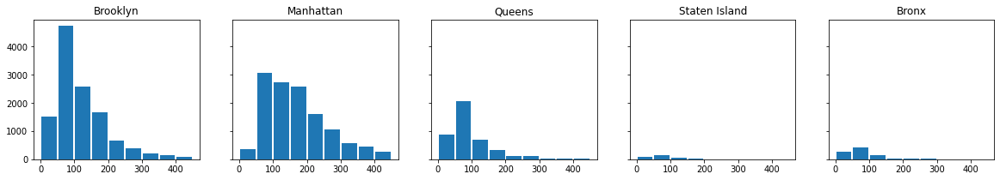

In [ ]:
fig, axs = plt.subplots(1, 5, figsize=(20, 3), sharey=True)
attemptBrooklyn = []
attemptManhattan = []
attemptBronx = []
attemptQueens = []
attemptStaten = []

for i in dfAvail[["neighbourhood_group","price"]].values:
    if(i[0] == "Brooklyn"):
      attemptBrooklyn.append(i[1])
    elif(i[0] == "Manhattan"):
      attemptManhattan.append(i[1])
    elif(i[0] == "Queens"):
      attemptQueens.append(i[1])
    elif(i[0] == "Staten Island"):
      attemptStaten.append(i[1])
    elif(i[0] == "Bronx"):
      attemptBronx.append(i[1])

axs[0].hist(attemptBrooklyn,bins=[0,50,100,150,200,250,300,350,400,450],rwidth=0.9 )
axs[0].title.set_text('Brooklyn')

axs[1].hist(attemptManhattan,bins=[0,50,100,150,200,250,300,350,400,450],rwidth=0.9 )
axs[1].title.set_text('Manhattan')

axs[2].hist(attemptQueens,bins=[0,50,100,150,200,250,300,350,400,450],rwidth=0.9 )
axs[2].title.set_text('Queens')

axs[3].hist(attemptStaten,bins=[0,50,100,150,200,250,300,350,400,450],rwidth=0.9 )
axs[3].title.set_text('Staten Island')

axs[4].hist(attemptBronx,bins=[0,50,100,150,200,250,300,350,400,450],rwidth=0.9 )
axs[4].title.set_text('Bronx')

####Price category distribution 
In each neighbourhood group we make a pie chart to represent the percentage of each category.

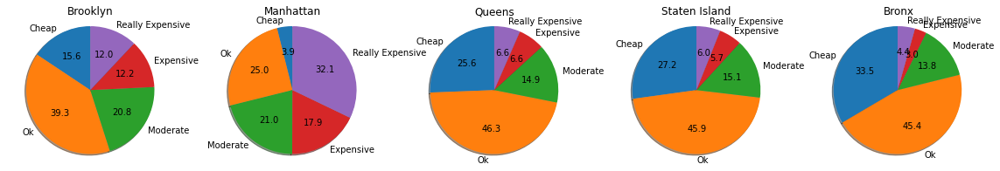

In [ ]:
import warnings
warnings.simplefilter("ignore", UserWarning)

fig, axs = plt.subplots(1, 5, figsize=(20, 3), sharey=True)

BrooklynPie = [0 ,0, 0, 0, 0]
BrooklynPie[0] = dfBrooklynAvail[dfBrooklynAvail["price"] <= 50]["price"].count()
BrooklynPie[1] = dfBrooklynAvail[dfBrooklynAvail["price"] <= 100 ][dfBrooklynAvail["price"] > 50 ]["price"].count()
BrooklynPie[2] = dfBrooklynAvail[dfBrooklynAvail["price"] <= 150 ][dfBrooklynAvail["price"] > 100 ]["price"].count()
BrooklynPie[3] = dfBrooklynAvail[dfBrooklynAvail["price"] <= 200 ][dfBrooklynAvail["price"] > 150 ]["price"].count()
BrooklynPie[4] = dfBrooklynAvail[dfBrooklynAvail["price"] > 200]["price"].count()

explode = (0 , 0, 0, 0, 0)

labels = 'Cheap', 'Ok', 'Moderate', 'Expensive' ,'Really Expensive'
axs[0].pie(BrooklynPie, explode=explode, labels=labels, autopct='%.1f',
          shadow=True, startangle=90)
axs[0].axis('equal')  

ManhattanPie = [0 ,0, 0, 0, 0]
ManhattanPie[0] = dfManhattanAvail[dfManhattanAvail["price"] <= 50]["price"].count()
ManhattanPie[1] = dfManhattanAvail[dfManhattanAvail["price"] <= 100 ][dfManhattanAvail["price"] > 50 ]["price"].count()
ManhattanPie[2] = dfManhattanAvail[dfManhattanAvail["price"] <= 150 ][dfManhattanAvail["price"] > 100 ]["price"].count()
ManhattanPie[3] = dfManhattanAvail[dfManhattanAvail["price"] <= 200 ][dfManhattanAvail["price"] > 150 ]["price"].count()
ManhattanPie[4] = dfManhattanAvail[dfManhattanAvail["price"] > 200]["price"].count()

explode = (0 , 0, 0, 0, 0)

labels = 'Cheap', 'Ok', 'Moderate', 'Expensive' ,'Really Expensive'
axs[1].pie(ManhattanPie, explode=explode, labels=labels, autopct='%.1f',
          shadow=True, startangle=90)
axs[1].axis('equal')

QueensPie = [0 ,0, 0, 0, 0]
QueensPie[0] = dfQueensAvail[dfQueensAvail["price"] <= 50]["price"].count()
QueensPie[1] = dfQueensAvail[dfQueensAvail["price"] <= 100 ][dfQueensAvail["price"] > 50 ]["price"].count()
QueensPie[2] = dfQueensAvail[dfQueensAvail["price"] <= 150 ][dfQueensAvail["price"] > 100 ]["price"].count()
QueensPie[3] = dfQueensAvail[dfQueensAvail["price"] <= 200 ][dfQueensAvail["price"] > 150 ]["price"].count()
QueensPie[4] = dfQueensAvail[dfQueensAvail["price"] > 200]["price"].count()

explode = (0 , 0, 0, 0, 0)

labels = 'Cheap', 'Ok', 'Moderate', 'Expensive' ,'Really Expensive'
axs[2].pie(QueensPie, explode=explode, labels=labels, autopct='%.1f',
          shadow=True, startangle=90)
axs[2].axis('equal')

StatenPie = [0 ,0, 0, 0, 0]
StatenPie[0] = dfStatenAvail[dfStatenAvail["price"] <= 50]["price"].count()
StatenPie[1] = dfStatenAvail[dfStatenAvail["price"] <= 100 ][dfStatenAvail["price"] > 50 ]["price"].count()
StatenPie[2] = dfStatenAvail[dfStatenAvail["price"] <= 150 ][dfStatenAvail["price"] > 100 ]["price"].count()
StatenPie[3] = dfStatenAvail[dfStatenAvail["price"] <= 200 ][dfStatenAvail["price"] > 150 ]["price"].count()
StatenPie[4] = dfStatenAvail[dfStatenAvail["price"] > 200]["price"].count()

explode = (0 , 0, 0, 0, 0)

labels = 'Cheap', 'Ok', 'Moderate', 'Expensive' ,'Really Expensive'
axs[3].pie(StatenPie, explode=explode, labels=labels, autopct='%.1f',
          shadow=True, startangle=90)
axs[3].axis('equal')

BronxPie = [0 ,0, 0, 0, 0]
BronxPie[0] = dfBronxAvail[dfBronxAvail["price"] <= 50]["price"].count()
BronxPie[1] = dfBronxAvail[dfBronxAvail["price"] <= 100 ][dfBronxAvail["price"] > 50 ]["price"].count()
BronxPie[2] = dfBronxAvail[dfBronxAvail["price"] <= 150 ][dfBronxAvail["price"] > 100 ]["price"].count()
BronxPie[3] = dfBronxAvail[dfBronxAvail["price"] <= 200 ][dfBronxAvail["price"] > 150 ]["price"].count()
BronxPie[4] = dfBronxAvail[dfBronxAvail["price"] > 200]["price"].count()

explode = (0 , 0, 0, 0, 0)

labels = 'Cheap', 'Ok', 'Moderate', 'Expensive' ,'Really Expensive'
axs[4].pie(BronxPie, explode=explode, labels=labels, autopct='%.1f',
          shadow=True, startangle=90)
axs[4].axis('equal')
 


axs[0].title.set_text('Brooklyn')


axs[1].title.set_text('Manhattan')


axs[2].title.set_text('Queens')

axs[3].title.set_text('Staten Island')


axs[4].title.set_text('Bronx')
  # At the end, plt.show() will be called
plt.show()


#####Some observations regarding price category distributions

Manhattan has a whopping 50% in the expensive and really expensive distribution with a measly 4% considered as cheap.

Bronx has the highest percentage of cheap AirBnBS compared to the others at 33.5 %.

Queens , Staten Island and Bronx have similar distributions while Brooklyn is slightly different.

According to these charts, its quite clear that Manhattan has the least options for people with tight budget while the other neighbourhood groups offer more in terms of price, especially the Bronx.

#Taking a look at a Supplementary Dataset
Investigating a factor in the price difference of AirBNB pricing is the number of arrests. So we use the dataset ->
https://data.cityofnewyork.us/Public-Safety/NYPD-Arrest-Data-Year-to-Date-/uip8-fykcThis 

This Dataset includes every arrest that happened in the NY region in the year 2019. The Dataset provides the longitude and latitude of every crime in the NY region. It is categorized, among other things, by districts and neighborhoods which helps us look into whether price and crime are correlated.

Because of the above reasons, this dataset seemed perfect to investigate.

We decided to make the dataset smaller to encompass crimes that occurred in the last month since it would make sense that the most recent date would most accurately represent the state of crime in NY. 

In [ ]:
data_path = "/content/gdrive/My Drive"
filename = "NYPD_Arrest_Data__Year_to_Date_.csv"

df2 = pd.read_csv(join(data_path, filename), delimiter = ",")
df2 = df2[:29183]#last month

df2.tail()

,ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
29178,204442046,11/01/2019,101.0,ASSAULT 3,344.0,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,Q,105,0,25-44,F,BLACK,1057693,204242,40.726977,-73.735025
29179,204442026,11/01/2019,569.0,"MARIJUANA, SALE 4 & 5",235.0,DANGEROUS DRUGS,PL 2214000,M,B,46,0,45-64,M,BLACK,1010747,249575,40.851669,-73.904223
29180,204442926,11/01/2019,729.0,"FORGERY,ETC.,UNCLASSIFIED-FELO",113.0,FORGERY,PL 1702500,F,K,79,0,45-64,M,UNKNOWN,999142,192610,40.695342,-73.946298
29181,204442685,11/01/2019,916.0,LEAVING SCENE-ACCIDENT-PERSONA,348.0,VEHICLE AND TRAFFIC LAWS,VTL06000AA,M,M,1,0,45-64,M,WHITE HISPANIC,982965,202085,40.721361,-74.004637
29182,204442446,11/01/2019,339.0,"LARCENY,PETIT FROM OPEN AREAS,",341.0,PETIT LARCENY,PL 1552500,M,Q,107,0,25-44,M,BLACK,1043480,208981,40.740091,-73.786263


##Plotting on Maps:
We plotted the AirBnBs and arrests in 2 different maps, one of the district with the highest percent of cheap AirBnBs (Bronx) and the other of the district with highest percent of expensive AirBnBs (Manhattan).

The price category of the AirBNBS are color coded:

<font color='red'>Cheap</font>

<font color='orange'>Okay</font>

<font color='green'>Moderate</font>

<font color='purple'>Expensive</font>

<font color='pink'>Really Expensive</font>

Arrests are also represented as blue:
<font color='blue'>Arrests</font>

In [ ]:
import folium
lat = dfBronx["latitude"].mean()
lng = dfBronx["longitude"].mean()

visited = []


BronxMap = folium.Map(location=[lat, lng], zoom_start=15)

for i in dfBronx[["latitude", "longitude","price_category"]].values:
  loc = (i[0],i[1])
  if(i[2] == "Cheap"):
    folium.CircleMarker(location=[loc[0],loc[1]],popup='Cheap',radius=5,color='red',fill=True,fill_color='##FF0000').add_to(BronxMap)
    visited.append(loc)
  elif(i[2] == "Ok"):
    folium.CircleMarker(location=[loc[0],loc[1]],popup='OK',radius=5,color='orange',fill=True,fill_color='##FF0000').add_to(BronxMap)
    visited.append(loc)
  elif(i[2] == "Moderate"):
    folium.CircleMarker(location=[loc[0],loc[1]],popup='Moderate',radius=5,color='green',fill=True,fill_color='##FF0000').add_to(BronxMap)
    visited.append(loc)
  elif(i[2] == "Expensive"):
    folium.CircleMarker(location=[loc[0],loc[1]],popup='Expensive',radius=5,color='purple',fill=True,fill_color='##FF0000').add_to(BronxMap)
    visited.append(loc)
  elif(i[2] == "Really Expensive"):
    folium.CircleMarker(location=[loc[0],loc[1]],popup='Really Expensive',radius=5,color='pink',fill=True,fill_color='##FF0000').add_to(BronxMap)
    visited.append(loc)

counter = 0
df2Bronx = df2[df2["ARREST_BORO" ]== "B"]

for i in df2Bronx[["Latitude", "Longitude"]].values: 
  loc = (i[0],i[1])
  folium.CircleMarker(location=[loc[0],loc[1]],popup='arrests',radius=5,
                      color='blue',fill=True,fill_color='##FF0000').add_to(BronxMap) 
  visited.append(loc) 
  counter = counter + 1 
  if counter == 20000: 
    break

BronxMap

###Analyzing the Bronx Map

The above map stays in line with our conclusion of Bronx having the highest percent of cheap AirBnBs as the color red seems to be the most common. It is too difficult to observe only from this map whether the cheap AirBnBs always have crime around.

In [ ]:
import folium
df2Manhatten = df2[df2["ARREST_BORO" ]== "M"]

lat = dfManhattan["latitude"].mean()
lng = dfManhattan["longitude"].mean()

visited = []


ManMap = folium.Map(location=[lat, lng], zoom_start=15)

counter = 0

for i in dfManhattanAvail[["latitude", "longitude","price_category"]].values:
  loc = (i[0],i[1])
  if(i[2] == "Cheap"):
    folium.CircleMarker(location=[loc[0],loc[1]],popup='Cheap',radius=5,color='red',fill=True,fill_color='##FF0000').add_to(ManMap)
    visited.append(loc)
  elif(i[2] == "Ok"):
    folium.CircleMarker(location=[loc[0],loc[1]],popup='OK',radius=5,color='orange',fill=True,fill_color='##FF0000').add_to(ManMap)
    visited.append(loc)
  elif(i[2] == "Moderate"):
    folium.CircleMarker(location=[loc[0],loc[1]],popup='Moderate',radius=5,color='green',fill=True,fill_color='##FF0000').add_to(ManMap)
    visited.append(loc)
  elif(i[2] == "Expensive"):
    folium.CircleMarker(location=[loc[0],loc[1]],popup='Expensive',radius=5,color='purple',fill=True,fill_color='##FF0000').add_to(ManMap)
    visited.append(loc)
  elif(i[2] == "Really Expensive"):
    folium.CircleMarker(location=[loc[0],loc[1]],popup='Really Expensive',radius=5,color='pink',fill=True,fill_color='##FF0000').add_to(ManMap)
    visited.append(loc)

for i in df2Manhatten[["Latitude", "Longitude"]].values: 
  loc = (i[0],i[1])
  folium.CircleMarker(location=[loc[0],loc[1]],popup='arrests',radius=5,
                      color='blue',fill=True,fill_color='##FF0000').add_to(ManMap) 
  visited.append(loc) 
  counter = counter + 1 
  if counter == 20000: 
    break


  



ManMap

###Analyzing the Manhattan Map

The Manhattan map has a lot of expensive and really expensive(pink and purple) listings all over while also having a lot more AirBnBs in what seems to be a more dense area. 
Again it is too hard to tell what the correlation is between the crime and AirBnB pricing.

## Analyzing the rate of crime:
We can see in the pie chart and bar chart below that the rate of crime in each area is similar except for Staten island. Which we can assume is due to its lower population.

<function matplotlib.pyplot.show>

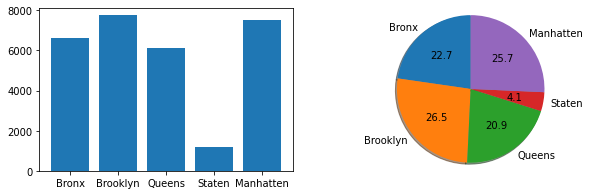

In [ ]:
CrimeCount = []
df2Brooklyn = df2[df2["ARREST_BORO" ]== "K"]
df2Queens = df2[df2["ARREST_BORO" ]== "Q"]
df2Staten = df2[df2["ARREST_BORO" ]== "S"]


CrimeCount.append(df2Bronx.ARREST_KEY.count())
CrimeCount.append(df2Brooklyn.ARREST_KEY.count())
CrimeCount.append(df2Queens.ARREST_KEY.count())
CrimeCount.append(df2Staten.ARREST_KEY.count())
CrimeCount.append(df2Manhatten.ARREST_KEY.count())
labels = 'Bronx', 'Brooklyn', 'Queens', 'Staten' ,'Manhatten'

fig, axs = plt.subplots(1, 2, figsize=(10, 3), sharey=False)


explode = (0 , 0, 0, 0, 0)

axs[0].bar(labels,CrimeCount)


axs[1].pie(CrimeCount, explode=explode, labels=labels, autopct='%.1f',
          shadow=True, startangle=90)
axs[1].axis('equal')




plt.show

##Scatterplots



###Plotting all arrests in scatterplot diffrentiated by district

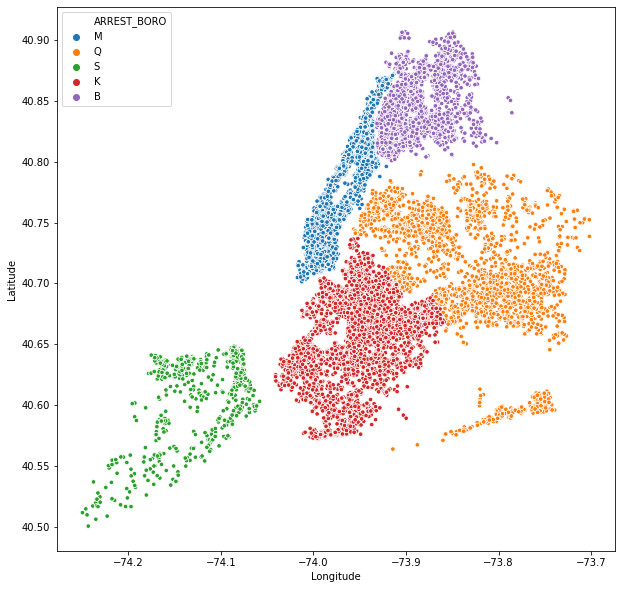

In [ ]:
import seaborn as sns

plt.figure(figsize=(10,10))
sns.scatterplot( x='Longitude',y='Latitude' ,hue='ARREST_BORO',s=20, data=df2)

###Plotting all AirBnBs in scatterplot diffrentiated by district

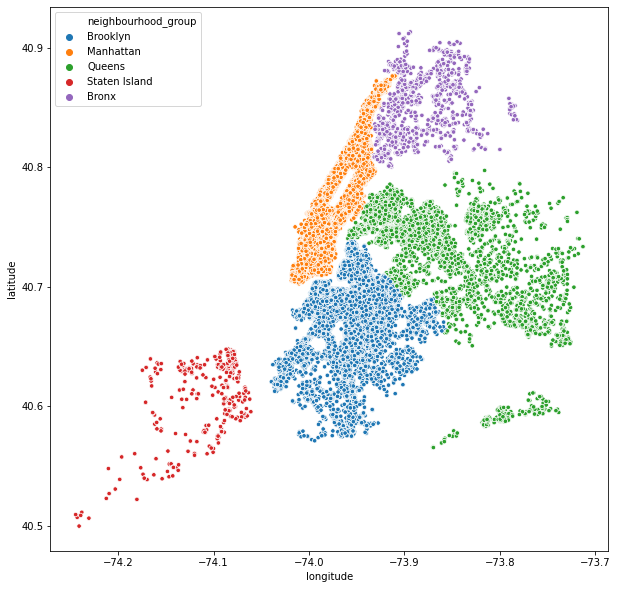

In [ ]:
import seaborn as sns

plt.figure(figsize=(10,10))
sns.scatterplot( x='longitude',y='latitude' ,hue='neighbourhood_group',s=20, data=df)

###Plotting all AirBnBs in scatterplot diffrentiated by price category. 

You can notice manhattan has more expensive AirBNBs while the other districts are more evenly distributed.

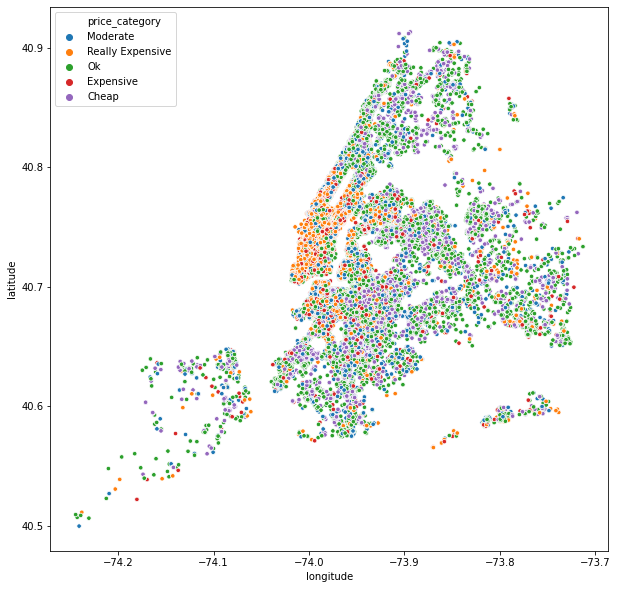

In [ ]:
plt.figure(figsize=(10,10))
sns.scatterplot( x='longitude',y='latitude' ,hue='price_category',s=20, data=df)

##Hypothesis Testing
In the following test, our hypotheses setting is the following:

$H_0$: `neighbourhood_group` and `price_category` are independent variables.

$H_A$: `neighbourhood_group` and `price_category` are **not** independent variables.

In [ ]:
priceranges = ["Cheap", "Ok", "Moderate", "Expensive","Really Expensive"]
crosstable = pd.crosstab(df["neighbourhood_group"], df["price_category"])
crosstable = crosstable[priceranges]
crosstable

price_category,Cheap,Ok,Moderate,Expensive,Really Expensive
neighbourhood_group,,,,,
Bronx,372,493,147,34,45
Brooklyn,3581,8190,4058,2220,2055
Manhattan,1036,5885,4891,3912,5937
Queens,1468,2633,878,365,322
Staten Island,104,166,55,23,25


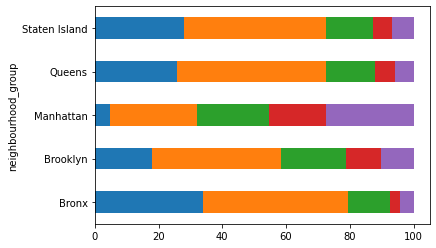

In [ ]:
from scipy import stats

result = crosstable.div(crosstable.sum(axis =1), axis=0)
result = result*100

z = result.plot.barh(stacked=True,legend=False)


In [ ]:
x = stats.chi2_contingency(crosstable)
x[1]

0.0

###Chi Test:
Using the chi test, we can confirm that neighbourhood_group and price_category are not independent variables since the pscore is 0 and that is less than a signifigance value of 0.05.

##Number of Crime
For each AirBnB, we make a 1 km radius around it and count each occurance of crime that occurs. We do this for each district seperately to speed up the process.

###Staten Island Crime:

In [ ]:
from geopy.distance import geodesic

def numberofcrimes(info):
  count = 0
  startpoint = (info[6],info[7])
  for i in df2Staten[["Latitude","Longitude"]].values:
    endpoint = (i[0],i[1])
    starttoend = geodesic(startpoint, endpoint).km
    if(starttoend <= 1): 
      count += 1
  return count
dfStaten["numberofcrime"] = dfStaten.apply(numberofcrimes, axis=1)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


In [ ]:
dfStaten.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_category,numberofcrime,crimeLevel
169,42882,New York room with a view,185978,Newyorkroomwithaview,Staten Island,St. George,40.64524,-74.08088,Private room,70,2,166,6/13/2019,1.66,1,312,Ok,277,average crime
249,62452,A SpeciaL!! Private Room in NY,303939,Lissette,Staten Island,Tompkinsville,40.63536,-74.08537,Private room,36,2,193,6/25/2019,1.85,6,360,Cheap,96,little crime
250,62461,B NYC Staten Alternative...,303939,Lissette,Staten Island,Tompkinsville,40.63627,-74.08543,Private room,37,2,147,6/10/2019,1.44,6,0,Cheap,103,little crime
251,62787,C Private Room By The Ferry,303939,Lissette,Staten Island,Tompkinsville,40.63518,-74.08546,Private room,37,2,177,7/2/2019,1.71,6,320,Cheap,95,little crime
256,63320,D Private Che@p Room 2 Explore NYC,303939,Lissette,Staten Island,Tompkinsville,40.63481,-74.08519,Private room,36,2,333,7/2/2019,3.19,6,340,Cheap,97,little crime


According the number of crime, we seperate them into 4 different categories:

###0 crime: self-explanatory

###Little crime: less than hundred

###Average crime: less than 250 more than 100

###A lot of crime: more than 250

In [ ]:
def crimelevel(info):
  if(info == 0):
    return "0 crime"
  elif(info < 100):
    return "little crime"
  elif(info < 250):
    return "average crime"
  else:
    return "lot of crime"

dfStaten["crimeLevel"] = dfStaten["numberofcrime"].apply(crimelevel)
dfStaten.numberofcrime.mean()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()


75.11796246648794

Making crosstable for ease of visualization for each district.

In [ ]:
priceranges = ["Cheap", "Ok", "Moderate", "Expensive","Really Expensive"]
crosstableStaten = pd.crosstab(dfStaten["crimeLevel"], dfStaten["price_category"])
crosstableStaten = crosstableStaten[priceranges]
crosstableStaten

price_category,Cheap,Ok,Moderate,Expensive,Really Expensive
crimeLevel,,,,,
average crime,5,16,5,1,1
little crime,91,123,42,18,22
lot of crime,8,27,8,4,2


For Staten island, its pretty inconclusive since each crime category is dominated by "cheap" and "ok".

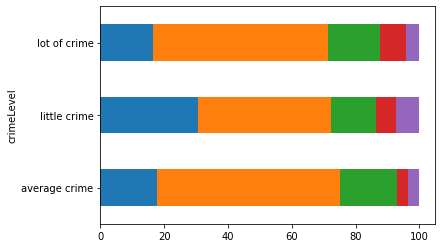

In [ ]:
result = crosstableStaten.div(crosstableStaten.sum(axis =1), axis=0)
result = result*100

z = result.plot.barh(stacked=True,legend=False)

###Brooklyn Crime:

In [ ]:
rownumber = 0
def numberofcrimes(info):
  global rownumber
  count = 0
  startpoint = (info[6],info[7])
  for i in df2Brooklyn[["Latitude","Longitude"]].values:
    endpoint = (i[0],i[1])
    starttoend = geodesic(startpoint, endpoint).km
    if(starttoend <= 1): 
      count += 1
  rownumber+=1
  
  
  return count
dfBrooklynSample["numberofcrime"] = dfBrooklynSample.apply(numberofcrimes, axis=1)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  from ipykernel import kernelapp as app


In [ ]:
dfBrooklynSample["crimeLevel"] = dfBrooklynSample["numberofcrime"].apply(crimelevel)

dfBrooklynSample.head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_category,numberofcrime,crimeLevel
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,10/19/2018,0.21,6,365,Moderate,68,little crime
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,7/5/2019,4.64,1,194,Ok,199,average crime
12,5803,"Lovely Room 1, Garden, Best Area, Legal rental",9744,Laurie,Brooklyn,South Slope,40.66829,-73.98779,Private room,89,4,167,6/24/2019,1.34,3,314,Ok,78,little crime
15,6848,Only 2 stops to Manhattan studio,15991,Allen & Irina,Brooklyn,Williamsburg,40.70837,-73.95352,Entire home/apt,140,2,148,6/29/2019,1.20,1,46,Moderate,205,average crime
16,7097,Perfect for Your Parents + Garden,17571,Jane,Brooklyn,Fort Greene,40.69169,-73.97185,Entire home/apt,215,2,198,6/28/2019,1.72,1,321,Really Expensive,219,average crime


In [ ]:
priceranges = ["Cheap", "Ok", "Moderate", "Expensive","Really Expensive"]
crosstableBrooklyn = pd.crosstab(dfBrooklynSample["crimeLevel"], dfBrooklynSample["price_category"])
crosstableBrooklyn = crosstableBrooklyn[priceranges]
crosstableBrooklyn

price_category,Cheap,Ok,Moderate,Expensive,Really Expensive
crimeLevel,,,,,
average crime,27,180,111,64,65
little crime,20,87,82,74,64
lot of crime,26,96,53,28,23


For Brooklyn, it seems that the little crime category has a bigger percantage of expensive and really expensive compared to the other two categgories.

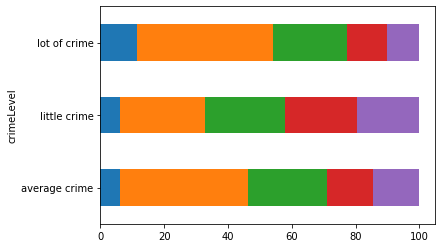

In [ ]:
result = crosstableBrooklyn.div(crosstableBrooklyn.sum(axis =1), axis=0)
result = result*100

z = result.plot.barh(stacked=True,legend=False)

###Manhattan Crime:


In [ ]:
def numberofcrimes(info):
  global rownumber
  count = 0
  startpoint = (info[6],info[7])
  for i in df2Manhatten[["Latitude","Longitude"]].values:
    endpoint = (i[0],i[1])
    starttoend = geodesic(startpoint, endpoint).km
    if(starttoend <= 1): 
      count += 1
  rownumber+=1
  
  
  return count
dfManhattanSample["numberofcrime"] = dfManhattanSample.apply(numberofcrimes, axis=1)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
dfManhattanSample["crimeLevel"] = dfManhattanSample["numberofcrime"].apply(crimelevel)

dfManhattanSample.head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_category,numberofcrime,crimeLevel
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,5/21/2019,0.38,2,355,Really Expensive,1003,lot of crime
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365,Moderate,817,lot of crime
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,6/22/2019,0.59,1,129,Expensive,277,lot of crime
7,5178,Large Furnished Room Near B'way,8967,Shunichi,Manhattan,Hell's Kitchen,40.76489,-73.98493,Private room,79,2,430,6/24/2019,3.47,1,220,Ok,641,lot of crime
9,5238,Cute & Cozy Lower East Side 1 bdrm,7549,Ben,Manhattan,Chinatown,40.71344,-73.99037,Entire home/apt,150,1,160,6/9/2019,1.33,4,188,Moderate,782,lot of crime


In [ ]:
priceranges = ["Cheap", "Ok", "Moderate", "Expensive","Really Expensive"]
crosstableMan = pd.crosstab(dfManhattanSample["crimeLevel"], dfManhattanSample["price_category"])
crosstableMan = crosstableMan[priceranges]
crosstableMan

price_category,Cheap,Ok,Moderate,Expensive,Really Expensive
crimeLevel,,,,,
average crime,5,50,49,42,41
little crime,0,3,3,4,0
lot of crime,24,233,197,145,204


The cheap sample size for Manhattan is small which lines up with our previous conclusion of AirBNBs in Manhattan being more expensive.
The crime also seems to be more rampant in manhattan, since there are few cases of little crime and they mostly converge to average and to lot of crime.

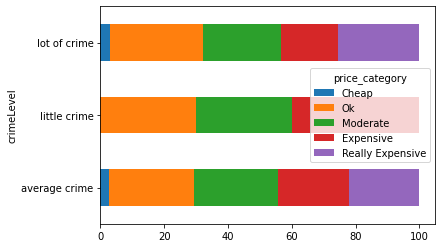

In [ ]:
result = crosstableMan.div(crosstableMan.sum(axis =1), axis=0)
result = result*100

z = result.plot.barh(stacked=True,legend=True)

###Bronx Crime:

In [ ]:
def numberofcrimes(info):
  global rownumber
  count = 0
  startpoint = (info[6],info[7])
  for i in df2Bronx[["Latitude","Longitude"]].values:
    endpoint = (i[0],i[1])
    starttoend = geodesic(startpoint, endpoint).km
    if(starttoend <= 1): 
      count += 1
  rownumber+=1
  
  
  return count
dfBronx["numberofcrime"] = dfBronx.apply(numberofcrimes, axis=1)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
dfBronx["crimeLevel"] = dfBronx["numberofcrime"].apply(crimelevel)

dfBronx.head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_category,numberofcrime,crimeLevel
171,44096,Room with a View,190409,Waundell,Bronx,Highbridge,40.83232,-73.93184,Private room,40,1,219,7/4/2019,2.04,3,353,Cheap,178,average crime
207,54626,Cozy bedroom by Yankee Stadium,190409,Waundell,Bronx,Highbridge,40.83075,-73.93058,Private room,45,1,138,6/30/2019,1.45,3,323,Cheap,259,lot of crime
260,63588,LL3,295128,Carol Gloria,Bronx,Clason Point,40.81309,-73.85514,Private room,90,2,0,NaN,NaN,7,349,Ok,49,little crime
261,63610,DOMINIQUE'S NY mini efficiency* wifi*metro*quiet,310670,Vie,Bronx,Eastchester,40.88057,-73.83572,Entire home/apt,105,2,38,6/27/2019,0.50,13,365,Moderate,56,little crime
309,71812,Condo Apartment with laundry in unit,369015,Thai,Bronx,Kingsbridge,40.87207,-73.90193,Entire home/apt,90,30,4,1/2/2019,0.35,2,346,Ok,332,lot of crime


In [ ]:
priceranges = ["Cheap", "Ok", "Moderate", "Expensive","Really Expensive"]
crosstableBronx = pd.crosstab(dfBronx["crimeLevel"], dfBronx["price_category"])
crosstableBronx = crosstableBronx[priceranges]
crosstableBronx

price_category,Cheap,Ok,Moderate,Expensive,Really Expensive
crimeLevel,,,,,
average crime,111,125,28,9,16
little crime,67,104,36,6,17
lot of crime,194,264,83,19,12


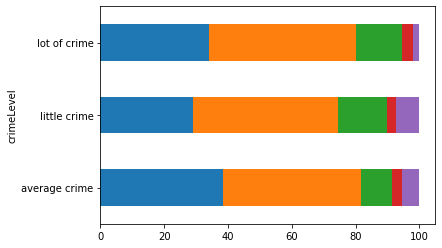

In [ ]:
result = crosstableBronx.div(crosstableBronx.sum(axis =1), axis=0)
result = result*100

z = result.plot.barh(stacked=True,legend=False)

###Queens Crime:

In [ ]:
def numberofcrimes(info):
  global rownumber
  count = 0
  startpoint = (info[6],info[7])
  for i in df2Queens[["Latitude","Longitude"]].values:
    endpoint = (i[0],i[1])
    starttoend = geodesic(startpoint, endpoint).km
    if(starttoend <= 1): 
      count += 1
  rownumber+=1
  
  
  return count
dfQueensSample["numberofcrime"] = dfQueensSample.apply(numberofcrimes, axis=1)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
dfQueensSample["crimeLevel"] = dfQueensSample["numberofcrime"].apply(crimelevel)

dfQueensSample.head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_category,numberofcrime,crimeLevel
46,12937,"1 Stop fr. Manhattan! Private Suite,Landmark B...",50124,Orestes,Queens,Long Island City,40.74771,-73.94740,Private room,130,3,248,7/1/2019,2.25,1,215,Moderate,129,average crime
77,18198,Little King of Queens,70091,Justin,Queens,Woodside,40.75038,-73.90334,Private room,70,30,25,5/31/2019,0.22,1,324,Ok,101,average crime
143,32363,Fully Furnished Basement Apartment,140025,Fredah,Queens,Flushing,40.74028,-73.83168,Private room,140,2,1,9/19/2011,0.01,1,1,Moderate,17,little crime
161,39593,"A room w/ a Manhattan view, longer stay",110506,Myung,Queens,Sunnyside,40.74559,-73.92313,Private room,79,30,28,4/12/2019,0.26,1,126,Ok,40,little crime
181,45910,Beautiful Queens Brownstone! - 5BR,204539,Mark,Queens,Ridgewood,40.70382,-73.89797,Entire home/apt,350,8,10,5/12/2019,0.11,5,365,Really Expensive,195,average crime


In [ ]:
priceranges = ["Cheap", "Ok", "Moderate", "Expensive","Really Expensive"]
crosstableQueens = pd.crosstab(dfQueensSample["crimeLevel"], dfQueensSample["price_category"])
crosstableQueens = crosstableQueens[priceranges]
crosstableQueens

price_category,Cheap,Ok,Moderate,Expensive,Really Expensive
crimeLevel,,,,,
average crime,65,193,58,23,15
little crime,107,274,96,39,45
lot of crime,31,31,15,5,3


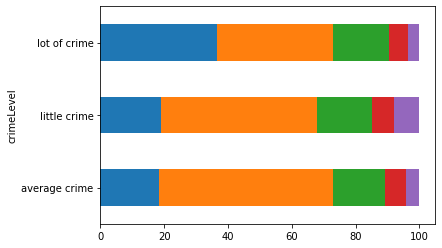

In [ ]:
result = crosstableQueens.div(crosstableQueens.sum(axis =1), axis=0)
result = result*100

z = result.plot.barh(stacked=True,legend=False)

###Combining all Districts:
We combined all the district into one dataframe to analyze:

In [ ]:
frame = [dfStaten, dfBrooklynSample,dfQueensSample,dfManhattanSample,dfBronx]
CombinedDF = pd.concat(frame)
CombinedDF.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_category,numberofcrime,crimeLevel
169,42882,New York room with a view,185978,Newyorkroomwithaview,Staten Island,St. George,40.64524,-74.08088,Private room,70,2,166,6/13/2019,1.66,1,312,Ok,277,lot of crime
249,62452,A SpeciaL!! Private Room in NY,303939,Lissette,Staten Island,Tompkinsville,40.63536,-74.08537,Private room,36,2,193,6/25/2019,1.85,6,360,Cheap,96,little crime
250,62461,B NYC Staten Alternative...,303939,Lissette,Staten Island,Tompkinsville,40.63627,-74.08543,Private room,37,2,147,6/10/2019,1.44,6,0,Cheap,103,average crime
251,62787,C Private Room By The Ferry,303939,Lissette,Staten Island,Tompkinsville,40.63518,-74.08546,Private room,37,2,177,7/2/2019,1.71,6,320,Cheap,95,little crime
256,63320,D Private Che@p Room 2 Explore NYC,303939,Lissette,Staten Island,Tompkinsville,40.63481,-74.08519,Private room,36,2,333,7/2/2019,3.19,6,340,Cheap,97,little crime


In [ ]:
priceranges = ["Cheap", "Ok", "Moderate", "Expensive","Really Expensive"]
crosstableALL = pd.crosstab(CombinedDF["price_category"], CombinedDF["crimeLevel"])
crosstableALL = crosstableALL.reindex(priceranges)
crosstableALL

crimeLevel,average crime,little crime,lot of crime
price_category,,,
Cheap,213,285,283
Ok,564,591,651
Moderate,251,259,356
Expensive,139,141,201
Really Expensive,138,148,244


####Results for all NY
Taking all of New York into consideration, it seems the rate of crime around all price categories is very similar.
Really expensive actually has the greatest percentage of a lot of crime compared to the other areas. 

####Correlating Price and Crime:

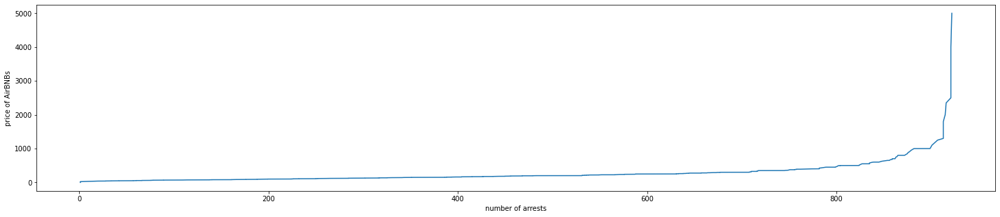

In [ ]:
fig, axs = plt.subplots(1, 1, figsize=(25, 5), sharey=False)

x = new.numberofcrime.sort_values(ascending=True)
y = new.price.sort_values(ascending=True)
axs.plot(x,y)


axs.set_xlabel('number of arrests')
axs.set_ylabel('price of AirBNBs')

plt.show()

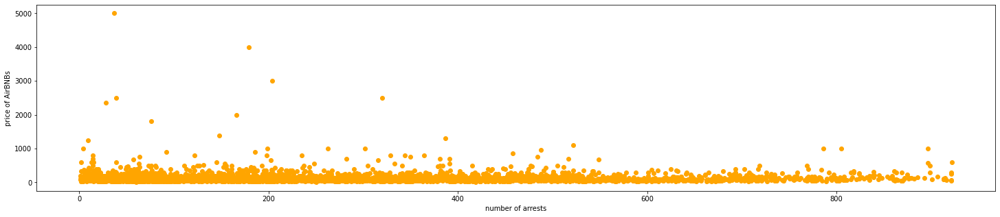

In [ ]:
fig, axs = plt.subplots(1, 1, figsize=(25, 5), sharey=False)

x = new.numberofcrime.sort_values(ascending=True)
y = new.price.sort_values(ascending=True)
axs.scatter(new.numberofcrime,new.price,color = 'orange')


axs.set_xlabel('number of arrests')
axs.set_ylabel('price of AirBNBs')

plt.show()

In [ ]:
CombinedDF.id.count()

4464

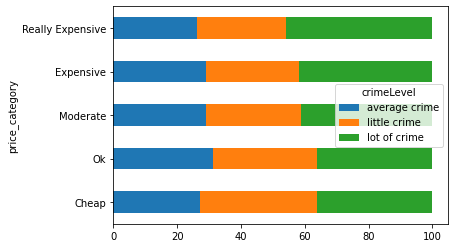

In [ ]:
result = crosstableALL.div(crosstableALL.sum(axis =1), axis=0)
result = result*100

z = result.plot.barh(stacked=True,legend=True)

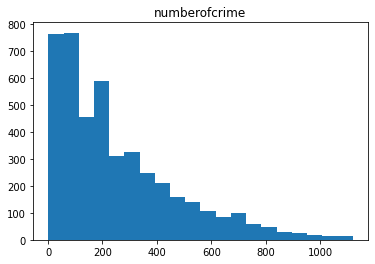

In [ ]:
CombinedDF.hist(column="numberofcrime",bins=20,grid=False)
CombinedDFnocrime = CombinedDF[CombinedDF["crimeLevel"] == "0 crime"]


Mean of number of crime of cheap AirBnBs is actually less than the number of crime of expensive AirBnBs.

In [ ]:
CombinedDFCheap = CombinedDF[CombinedDF["price_category"] == "Cheap"]
CombinedDFExpensive = CombinedDF[CombinedDF["price_category"] == "Really Expensive"]
print("Total Average:",CombinedDF.numberofcrime.mean())
print("Expensive Average:",CombinedDFExpensive.numberofcrime.mean())
print("Cheap Average:",CombinedDFCheap.numberofcrime.mean())

Total Average: 253.67674731182797
Expensive Average: 309.55283018867925
Cheap Average: 229.85659411011522


####Investigating and removing outliers:


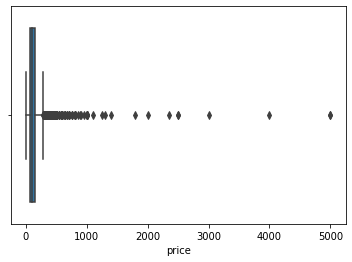

In [ ]:
import seaborn as sns
sns.boxplot(x=CombinedDF.price)


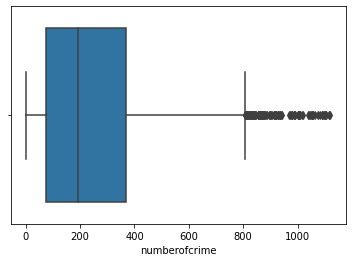

In [ ]:
import seaborn as sns
sns.boxplot(x=CombinedDF.numberofcrime)


Removing Price and Crime Outliers:

In [ ]:
from scipy import stats
z = np.abs(stats.zscore(CombinedDF.price))

threshold = 3

x = np.where(z > 3)
new = CombinedDF.reset_index()
for i in x:
  new = new.drop(i)
new = CombinedDF.reset_index()

z = np.abs(stats.zscore(CombinedDF.numberofcrime))

threshold = 3

x = np.where(z > 3)
new = CombinedDF.reset_index()
for i in x:
  new = new.drop(i)

new.head()

,index,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_category,numberofcrime,crimeLevel
0,169,42882,New York room with a view,185978,Newyorkroomwithaview,Staten Island,St. George,40.64524,-74.08088,Private room,70,2,166,6/13/2019,1.66,1,312,Ok,277,lot of crime
1,249,62452,A SpeciaL!! Private Room in NY,303939,Lissette,Staten Island,Tompkinsville,40.63536,-74.08537,Private room,36,2,193,6/25/2019,1.85,6,360,Cheap,96,little crime
2,250,62461,B NYC Staten Alternative...,303939,Lissette,Staten Island,Tompkinsville,40.63627,-74.08543,Private room,37,2,147,6/10/2019,1.44,6,0,Cheap,103,average crime
3,251,62787,C Private Room By The Ferry,303939,Lissette,Staten Island,Tompkinsville,40.63518,-74.08546,Private room,37,2,177,7/2/2019,1.71,6,320,Cheap,95,little crime
4,256,63320,D Private Che@p Room 2 Explore NYC,303939,Lissette,Staten Island,Tompkinsville,40.63481,-74.08519,Private room,36,2,333,7/2/2019,3.19,6,340,Cheap,97,little crime


###T test

Next we wanted to investigate whether the rate of crime is different in cheap and non cheap place

$\mu_{non-cheap}$: average crime of non-cheap AirBnBs

$\mu_{cheap}$: average crime of cheap AirBnBs

$H_0: \mu_{non-cheap} = \mu_{cheap}$  
$H_A: \mu_{non-cheap} \neq \mu_{cheap}$

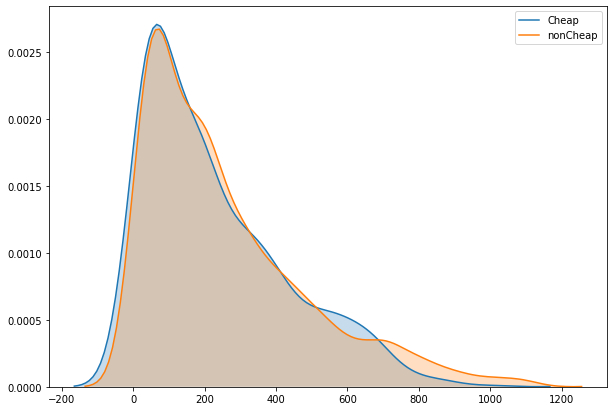

In [ ]:
import seaborn as sns
Cheap = CombinedDF[(CombinedDF["price_category"] == "Cheap") ]["numberofcrime"]
nonCheap = CombinedDF[(CombinedDF["price_category"] != "Cheap")]["numberofcrime"]

fig, ax = plt.subplots(1,1, figsize=(10,7))

sns.kdeplot(Cheap, shade=True, ax=ax, label="Cheap")
sns.kdeplot(nonCheap, shade=True, ax=ax, label="nonCheap")
plt.show()

In [ ]:
eh , pvalue = stats.ttest_ind(Cheap , nonCheap,equal_var=False)
print(pvalue)

0.00034483645497023423


####Some elementary conclusion:
Although the graphs are very similar and seems to have no difference, the chi test p value is **0.0003** which is less than a significance level of **0.005**. Therefore, the two values are no equal and the null hypothesis is rejected.

This might be a type 1 error(falsely rejecting) ,and a lower significance value is needed.

###Another T test
Next we wanted to investigate whether the rate of crime is different in Expensive and non Expensive place.

$\mu_{non-Expensive}$: average crime of non-Expensive AirBnBs

$\mu_{Expensive}$: average crime of cheExpensiveap AirBnBs

$H_0: \mu_{non-Expensive} = \mu_{Expensive}$  
$H_A: \mu_{non-Expensive} \neq \mu_{Expensive}$

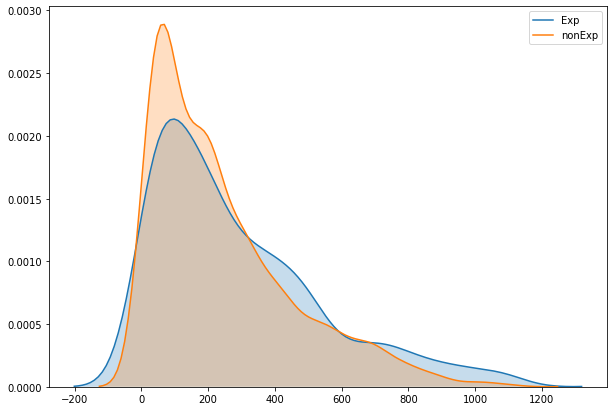

In [ ]:
# your code
import seaborn as sns
Exp = CombinedDF[(CombinedDF["price_category"] == "Expensive") | (CombinedDF["price_category"] == "Really Expensive" )]["numberofcrime"]
nonExp = CombinedDF[(CombinedDF["price_category"] != "Expensive") & (CombinedDF["price_category"] != "Really Expensive")]["numberofcrime"]

fig, ax = plt.subplots(1,1, figsize=(10,7))

sns.kdeplot(Exp, shade=True, ax=ax, label="Exp")
sns.kdeplot(nonExp, shade=True, ax=ax, label="nonExp")
plt.show()

In [ ]:
eh , pvalue = stats.ttest_ind(Exp , nonExp,equal_var=False)
print(pvalue)

9.664023064719315e-08


####Some elementary conclusion:
The two graphs have more difference this time, with the expensive AirBnBs having more crime. (x axis ticks represent number of crimes.)

Since the p value is 9.66*10<sup>-8</sup>, which is less than the significance value of 0.005. We reject the null hypothesis.

#Machine Learning Models

##KNN Models

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
CombinedDF.tail()


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_category,numberofcrime,crimeLevel
48783,36426093,Best room in nyc,273877318,Jay,Bronx,Claremont Village,40.83926,-73.91173,Private room,140,1,0,NaN,NaN,1,90,Moderate,511,lot of crime
48792,36428186,Private house Apartment,141511069,Carolina,Bronx,Morrisania,40.83146,-73.89666,Entire home/apt,80,7,0,NaN,NaN,1,71,Ok,314,lot of crime
48795,36429652,Cute double room for the perfect Yankee fan,58222366,Dominique,Bronx,Claremont Village,40.83502,-73.91058,Private room,125,2,0,NaN,NaN,1,364,Moderate,533,lot of crime
48796,36435986,1A. Studio & Stay. 30 minutes to Midtown Manha...,37678939,Chantal,Bronx,Concourse Village,40.83372,-73.91187,Private room,70,2,0,NaN,NaN,2,81,Ok,557,lot of crime
48805,36442252,1B-1B apartment near by Metro,273841667,Blaine,Bronx,Mott Haven,40.80787,-73.92400,Entire home/apt,100,1,2,7/7/2019,2.0,1,40,Ok,589,lot of crime


We convert all string parameters and such into integer parameter so that we can use a tree. We choose a number to represent a unique choice from a category and apply that function to our database. Afterwards, we drop all the columns that contain non-integer values. Our target column is the numbers for the price category column. Convertin cheap into 0 and Really expensive into 4.

In [ ]:
def targetcol(info):
  if info == "Cheap":
    return 0
  if info == "Ok":
    return 1
  if info == "Moderate":
    return 2
  if info == "Expensive":
    return 3
  if info == "Really Expensive":
    return 4   

def RoomType(info):
  if info == "Private room":
    return 0
  if info == "Entire home/apt":
    return 1
  else:
    return 2

def neighbourgroup(info):
  if info == "Staten Island":
    return 0
  if info == "Bronx":
    return 1
  if info == "Brooklyn":
    return 2
  if info == "Queens":
    return 3
  if info == "Manhattan":
    return 4

def crime(info):
  if info == "0 crime":
    return 0
  if info == "average crime":
    return 1
  if info == "little crime":
    return 2
  if info == "lot of crime":
    return 3
  
  
CombinedDF["Target"] = CombinedDF["price_category"].apply(targetcol)
CombinedDF["roomtype"] = CombinedDF["room_type"].apply(RoomType)
CombinedDF["group"] = CombinedDF["neighbourhood_group"].apply(neighbourgroup)
CombinedDF["crime"] = CombinedDF["crimeLevel"].apply(crime)
CombinedDF.head(5)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_category,numberofcrime,crimeLevel,Target,roomtype,group,crime
169,42882,New York room with a view,185978,Newyorkroomwithaview,Staten Island,St. George,40.64524,-74.08088,Private room,70,2,166,6/13/2019,1.66,1,312,Ok,277,lot of crime,1,0,0,3
249,62452,A SpeciaL!! Private Room in NY,303939,Lissette,Staten Island,Tompkinsville,40.63536,-74.08537,Private room,36,2,193,6/25/2019,1.85,6,360,Cheap,96,little crime,0,0,0,2
250,62461,B NYC Staten Alternative...,303939,Lissette,Staten Island,Tompkinsville,40.63627,-74.08543,Private room,37,2,147,6/10/2019,1.44,6,0,Cheap,103,average crime,0,0,0,1
251,62787,C Private Room By The Ferry,303939,Lissette,Staten Island,Tompkinsville,40.63518,-74.08546,Private room,37,2,177,7/2/2019,1.71,6,320,Cheap,95,little crime,0,0,0,2
256,63320,D Private Che@p Room 2 Explore NYC,303939,Lissette,Staten Island,Tompkinsville,40.63481,-74.08519,Private room,36,2,333,7/2/2019,3.19,6,340,Cheap,97,little crime,0,0,0,2


In [ ]:
X = CombinedDF.drop("name", axis=1)
X = X.drop("neighbourhood", axis=1)
X = X.drop("crimeLevel",axis=1)
X = X.drop("host_name",axis=1)
X = X.drop("room_type",axis=1)
X = X.drop("last_review",axis=1)
X = X.drop("price_category",axis=1)
X = X.drop("price",axis=1)
X = X.drop("neighbourhood_group",axis=1)
X = X.drop("Target",axis=1)
Z = X[["crime"]]
X.fillna({'reviews_per_month':0}, inplace=True)


,id,host_id,latitude,longitude,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,numberofcrime,roomtype,group,crime
169,42882,185978,40.64524,-74.08088,2,166,1.66,1,312,277,0,0,3
249,62452,303939,40.63536,-74.08537,2,193,1.85,6,360,96,0,0,2
250,62461,303939,40.63627,-74.08543,2,147,1.44,6,0,103,0,0,1
251,62787,303939,40.63518,-74.08546,2,177,1.71,6,320,95,0,0,2
256,63320,303939,40.63481,-74.08519,2,333,3.19,6,340,97,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...
48783,36426093,273877318,40.83926,-73.91173,1,0,0.00,1,90,511,0,1,3
48792,36428186,141511069,40.83146,-73.89666,7,0,0.00,1,71,314,1,1,3
48795,36429652,58222366,40.83502,-73.91058,2,0,0.00,1,364,533,0,1,3
48796,36435986,37678939,40.83372,-73.91187,2,0,0.00,2,81,557,0,1,3


In [ ]:
y = CombinedDF["Target"]

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split

from sklearn.metrics import accuracy_score
# 80% for training and 20% for testing-validation
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=1)
max1 = 0
bestk = 0

for k in range(1,25):
  knn = KNeighborsClassifier(k, metric="euclidean")
  knn.fit(X_train, y_train)
  y_pred = knn.predict(X_test)
  eucl_score = accuracy_score(y_test, y_pred)
  if eucl_score > max1:
    max1 = eucl_score
    bestk = k

print("The Best euclidean Accuracy = ", max1)
print("with k =" ,bestk)


The Best euclidean Accuracy =  0.38521836506159013
with k = 23


In [ ]:
max1 = 0
bestk = 0

for k in range(1,25):  
  knn = KNeighborsClassifier(k, metric="cityblock")
  knn.fit(X_train, y_train)
  y_pred = knn.predict(X_test)
  man_score = accuracy_score(y_test, y_pred)
  if  man_score > max1:
    max1 =  man_score
    bestk = k
print("The Best Manhattan Accuracy = ", max1)
print("with k =" ,bestk)

The Best Manhattan Accuracy =  0.39529675251959684
with k = 22


In [ ]:
max1 = 0
bestk = 0

for k in range(1,25):    
  knn = KNeighborsClassifier(k, metric="chebyshev")
  knn.fit(X_train, y_train)
  y_pred = knn.predict(X_test)
  cheb_score = accuracy_score(y_test, y_pred)
  if cheb_score > max1:
    max1 = cheb_score
    bestk = k

print("The Best chebyshev Accuracy = ", max1)
print("with k =" ,bestk)

The Best chebyshev Accuracy =  0.3840985442329227
with k = 23


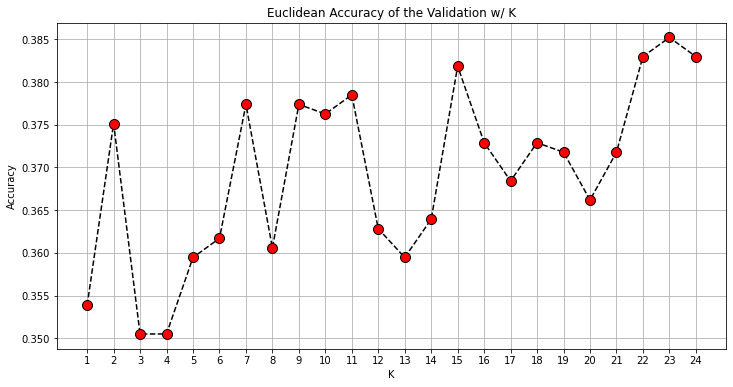

In [ ]:

K_range = np.arange(1, 25)
accuracy_list = []

for k in K_range:
  # create a new model with current K
  knn = KNeighborsClassifier(k, metric="euclidean")
  # fit training data
  knn.fit(X_train, y_train)
  # predict the validation data
  y_pred = knn.predict(X_test)
  # obtain the accuracy value
  accuracy = accuracy_score(y_test, y_pred)
  accuracy_list.append(accuracy)

plt.figure(figsize=(12, 6))  
plt.plot(K_range, accuracy_list, color='black', linestyle='dashed', marker='o',  
         markerfacecolor='red', markersize=10)
plt.title('Euclidean Accuracy of the Validation w/ K')  
plt.xlabel('K')  
plt.ylabel('Accuracy')
plt.xticks(K_range)
plt.grid()


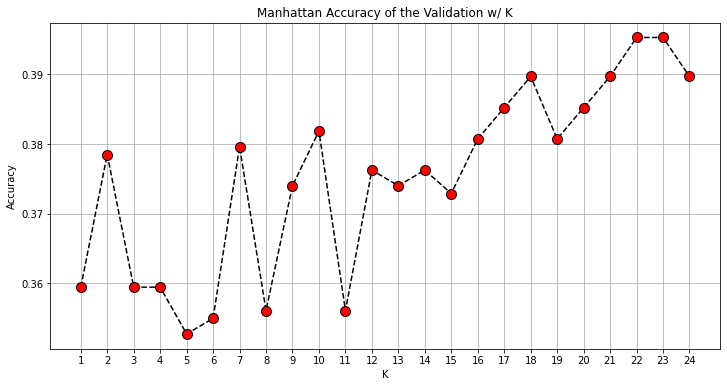

In [ ]:
K_range = np.arange(1, 25)
accuracy_list = []

for k in K_range:
  # create a new model with current K
  knn = KNeighborsClassifier(k, metric="cityblock")
  # fit training data
  knn.fit(X_train, y_train)
  # predict the validation data
  y_pred = knn.predict(X_test)
  # obtain the accuracy value
  accuracy = accuracy_score(y_test, y_pred)
  accuracy_list.append(accuracy)

plt.figure(figsize=(12, 6))  
plt.plot(K_range, accuracy_list, color='black', linestyle='dashed', marker='o',  
         markerfacecolor='red', markersize=10)
plt.title('Manhattan Accuracy of the Validation w/ K')  
plt.xlabel('K')  
plt.ylabel('Accuracy')
plt.xticks(K_range)
plt.grid()
plt.show()

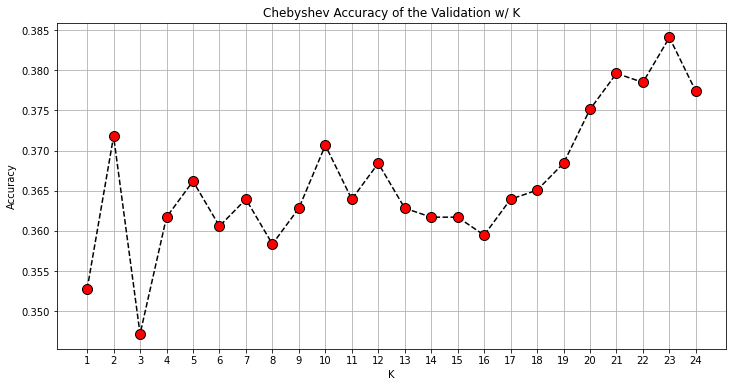

In [ ]:
K_range = np.arange(1, 25)
accuracy_list = []

for k in K_range:
  # create a new model with current K
  knn = KNeighborsClassifier(k, metric="chebyshev")
  # fit training data
  knn.fit(X_train, y_train)
  # predict the validation data
  y_pred = knn.predict(X_test)
  # obtain the accuracy value
  accuracy = accuracy_score(y_test, y_pred)
  accuracy_list.append(accuracy)

plt.figure(figsize=(12, 6))  
plt.plot(K_range, accuracy_list, color='black', linestyle='dashed', marker='o',  
         markerfacecolor='red', markersize=10)
plt.title('Chebyshev Accuracy of the Validation w/ K')  
plt.xlabel('K')  
plt.ylabel('Accuracy')
plt.xticks(K_range)
plt.grid()
plt.show()

In [ ]:
scaler = StandardScaler()
scaler.fit(X)
cool = scaler.transform(X)

X_train, X_test, y_train, y_test = train_test_split(cool, y, test_size=0.20, random_state=1)


In [ ]:
max1 = 0
bestk = 0

for k in range(1,25):
  knn = KNeighborsClassifier(k, metric="euclidean")
  knn.fit(X_train, y_train)
  y_pred = knn.predict(X_test)
  eucl_score = accuracy_score(y_test, y_pred)
  if eucl_score > max1:
    max1 = eucl_score
    bestk = k

print("The Best euclidean Accuracy = ", max1)
print("with k =" ,bestk)


The Best euclidean Accuracy =  0.5251959686450168
with k = 7


In [ ]:
max1 = 0
bestk = 0

for k in range(1,25):  
  knn = KNeighborsClassifier(k, metric="cityblock")
  knn.fit(X_train, y_train)
  y_pred = knn.predict(X_test)
  man_score = accuracy_score(y_test, y_pred)
  if  man_score > max1:
    max1 =  man_score
    bestk = k
print("The Best Manhattan Accuracy = ", max1)
print("with k =" ,bestk)

The Best Manhattan Accuracy =  0.5195968645016797
with k = 8


In [ ]:
for k in range(1,25):    
  knn = KNeighborsClassifier(k, metric="chebyshev")
  knn.fit(X_train, y_train)
  y_pred = knn.predict(X_test)
  cheb_score = accuracy_score(y_test, y_pred)
  if cheb_score > max1:
    max1 = cheb_score
    bestk = k

print("The Best chebyshev Accuracy = ", max1)
print("with k =" ,bestk)

The Best chebyshev Accuracy =  0.5195968645016797
with k = 8


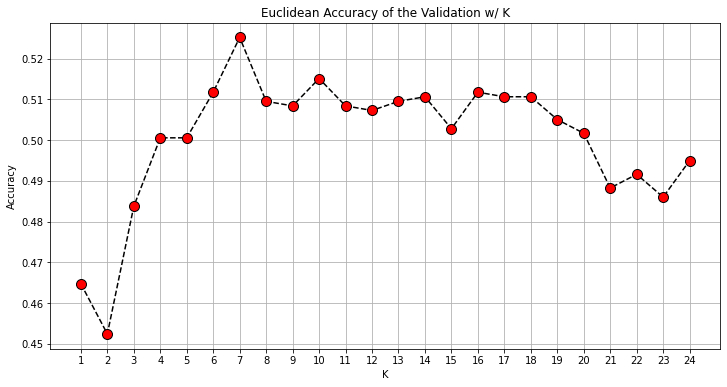

In [ ]:
K_range = np.arange(1, 25)
accuracy_list = []


for k in K_range:
  # create a new model with current K
  knn = KNeighborsClassifier(k, metric="euclidean")
  # fit training data
  knn.fit(X_train, y_train)
  # predict the validation data
  y_pred = knn.predict(X_test)
  # obtain the accuracy value
  accuracy = accuracy_score(y_test, y_pred)
  accuracy_list.append(accuracy)

plt.figure(figsize=(12, 6))  
plt.plot(K_range, accuracy_list, color='black', linestyle='dashed', marker='o',  
         markerfacecolor='red', markersize=10)
plt.title('Euclidean Accuracy of the Validation w/ K')  
plt.xlabel('K')  
plt.ylabel('Accuracy')
plt.xticks(K_range)
plt.grid()
plt.show()

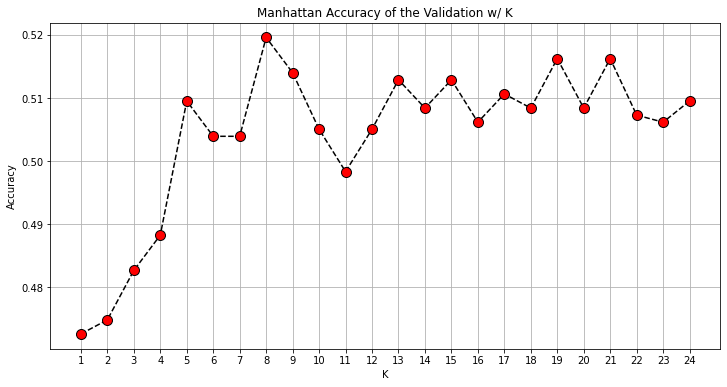

In [ ]:
K_range = np.arange(1, 25)
accuracy_list = []

for k in K_range:
  # create a new model with current K
  knn = KNeighborsClassifier(k, metric="cityblock")
  # fit training data
  knn.fit(X_train, y_train)
  # predict the validation data
  y_pred = knn.predict(X_test)
  # obtain the accuracy value
  accuracy = accuracy_score(y_test, y_pred)
  accuracy_list.append(accuracy)

plt.figure(figsize=(12, 6))  
plt.plot(K_range, accuracy_list, color='black', linestyle='dashed', marker='o',  
         markerfacecolor='red', markersize=10)
plt.title('Manhattan Accuracy of the Validation w/ K')  
plt.xlabel('K')  
plt.ylabel('Accuracy')
plt.xticks(K_range)
plt.grid()
plt.show()

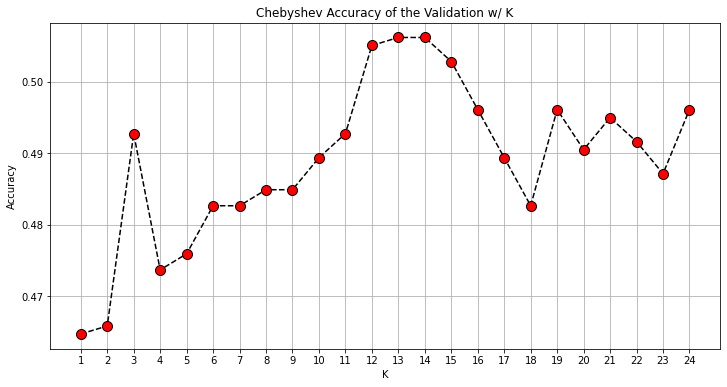

In [ ]:
K_range = np.arange(1, 25)
accuracy_list = []

for k in K_range:
  # create a new model with current K
  knn = KNeighborsClassifier(k, metric="chebyshev")
  # fit training data
  knn.fit(X_train, y_train)
  # predict the validation data
  y_pred = knn.predict(X_test)
  # obtain the accuracy value
  accuracy = accuracy_score(y_test, y_pred)
  accuracy_list.append(accuracy)

plt.figure(figsize=(12, 6))  
plt.plot(K_range, accuracy_list, color='black', linestyle='dashed', marker='o',  
         markerfacecolor='red', markersize=10)
plt.title('Chebyshev Accuracy of the Validation w/ K')  
plt.xlabel('K')  
plt.ylabel('Accuracy')
plt.xticks(K_range)
plt.grid()
plt.show()

####KNN Models Analysis

We first tried to apply knn as the machine learning method. We applied it using the three different methods and did hyperparameter tuning with k from 0 to 25 to find the best value for k. 
The best value out of the 6 was using euclidean distance on the scaled data-set with k=7 which yielded a .525 accuracy rate on our test data set.


| Distance Function     | Raw Features           | Standardized Features  |
| ------------- |-------------| ----------|
| Chebyshev     | 0.384 at k=23 | 0.519 at k=8|
| Euclidean    | 0.385 at k=22     |   0.525 at k=7 |
| Manhattan | 0.395 at k=23      |    0.519 at k=8 | 

##Decision Tree Models

In [ ]:
accuracy_list = []
accuracy_SD_list = []

for depth in range (1, 15):
  model = tree.DecisionTreeClassifier(min_samples_leaf= 2,max_depth=depth)
  accuracies_CV = cross_val_score(model, X_train, y_train, cv=5)
  accuracy_list.append(accuracies_CV.mean())
  accuracy_SD_list.append(accuracies_CV.std())

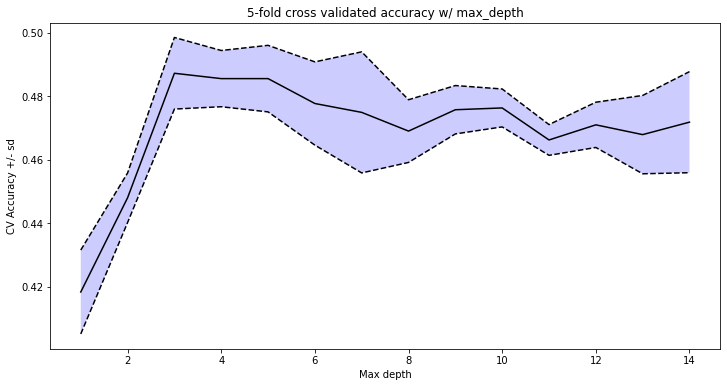

In [ ]:
plt.figure(figsize=(12, 6))  
plt.plot(range(1, 15), accuracy_list, color='black', linestyle='solid')
plt.plot(range(1, 15), np.array(accuracy_list) + np.array(accuracy_SD_list),color='black', linestyle='dashed')
plt.plot(range(1, 15), np.array(accuracy_list) - np.array(accuracy_SD_list),color='black', linestyle='dashed' )
plt.fill_between(range(1, 15), np.array(accuracy_list) + np.array(accuracy_SD_list),
                 np.array(accuracy_list) - np.array(accuracy_SD_list), alpha=0.2, facecolor ='b')
plt.plot()
plt.title('5-fold cross validated accuracy w/ max_depth')  
plt.xlabel('Max depth')  
plt.ylabel('CV Accuracy +/- sd') 
plt.show()

In [ ]:
from sklearn import tree
from sklearn.model_selection import cross_val_score

model1 = tree.DecisionTreeClassifier(min_samples_leaf= 1)
model2 = tree.DecisionTreeClassifier(min_samples_leaf= 2,max_depth=7)                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                
model3 = tree.DecisionTreeClassifier(min_samples_leaf= 5,max_depth=14,splitter = "best")      

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
accuracies = cross_val_score(model1, X_train, y_train, cv=5)
print("Accuracy for Model 1: %0.2f (+/- %0.2f)" % (accuracies.mean(), accuracies.std() * 2))
accuracies = cross_val_score(model2, X_train, y_train, cv=5)
print("Accuracy for Model 2: %0.2f (+/- %0.2f)" % (accuracies.mean(), accuracies.std() * 2))
accuracies = cross_val_score(model3, X_train, y_train, cv=5)
print("Accuracy for Model 3: %0.2f (+/- %0.2f)" % (accuracies.mean(), accuracies.std() * 2))

Accuracy for Model 1: 0.46 (+/- 0.03)
Accuracy for Model 2: 0.48 (+/- 0.04)
Accuracy for Model 3: 0.47 (+/- 0.03)


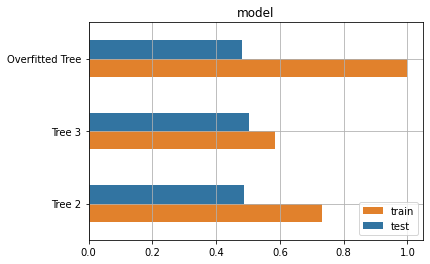

In [ ]:
model1.fit(X_train.to_numpy(),y_train.to_numpy())
model2.fit(X_train.to_numpy(),y_train.to_numpy())
model3.fit(X_train.to_numpy(),y_train.to_numpy())

y_pred = model1.predict(X_test)
# obtain the accuracy value
accuracy1 = accuracy_score(y_test, y_pred)

y_pred = model1.predict(X_train)
# obtain the accuracy value
accuracy2 = accuracy_score(y_train, y_pred)

y_pred = model2.predict(X_test)
# obtain the accuracy value
accuracy3 = accuracy_score(y_test, y_pred)

y_pred = model2.predict(X_train)
# obtain the accuracy value
accuracy4 = accuracy_score(y_train, y_pred)

y_pred = model3.predict(X_test)
# obtain the accuracy value
accuracy5 = accuracy_score(y_test, y_pred)

y_pred = model3.predict(X_train)
# obtain the accuracy value
accuracy6 = accuracy_score(y_train, y_pred)

data = [[ accuracy6,accuracy5], [ accuracy4,accuracy3],[accuracy2, accuracy1]]
result = pd.DataFrame(data, columns = ['train', 'test'], index=["Tree 2","Tree 3" ,"Overfitted Tree" ]) 
colors = "#e1812c" , "#3274a1"
z = result.plot.barh(stacked=False,legend=True,grid=True,title="model",color=colors )


| Trees    | Train Results           | Test Results  |
| ------------- |-------------| ----------|
| Overfitted    | 1 | 0.477|
| minleaf=2,depth=7   | 0.584     |   0.506 |
| minleaf=5,depth=5| 0.733     |  0.482    | 

##Conclusion

The overfitted model obviously performs best for the Training data set but performs the worst for the test data. The one that performed the best for the test data was the tree with the parameters of min_samples_leaf=2 and depth=7 with an accuracy percentage of 50.6 of guessing correct price range of a AirBnB. This is just short of the 52.5 percent of the euclidean knn model.

It seems it is not really applicable to find the price range of an AirBnB using only the number of crime around the AirBnB as the success rate is only 50% for picking between 5 categories which is better than random which is 20% but still not sufficient. 